In [1]:
# ============================================================
# INSTALL REQUIRED LIBRARIES
# ============================================================
!pip install -q rasterio earthpy plotly opencv-python scikit-image scikit-learn seaborn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.3/22.3 MB 24.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 18.7 MB/s eta 0:00:00


In [2]:
# ============================================================
# IMPORT LIBRARIES
# ============================================================
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.cluster import KMeans
from skimage import filters, segmentation, measure
from scipy import ndimage
import seaborn as sns
import pandas as pd
import os
from google.colab import files

In [5]:
# ============================================================
# MULTISPECTRAL ANALYZER CLASS
# ============================================================
class MultiSpectralCropAnalyzer:
    def __init__(self, image_path):
        """
        Initialize the analyzer with an RGB image
        """
        self.image_path = image_path
        self.rgb_image = None
        self.load_image()

    # ------------------------------------------------------------
    # LOAD IMAGE
    # ------------------------------------------------------------
    def load_image(self):
        """Load and preprocess the RGB image"""
        img = cv2.imread(self.image_path)
        if img is None:
            raise FileNotFoundError(f"Image not found at path: {self.image_path}")
        self.rgb_image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        print(f"Image loaded successfully. Shape: {self.rgb_image.shape}")

    # ------------------------------------------------------------
    # SIMULATE MULTISPECTRAL BANDS
    # ------------------------------------------------------------
    def simulate_multispectral_bands(self):
        """
        Simulate multispectral bands from RGB image
        This creates pseudo-NIR and other bands for demonstration
        """
        # Extract RGB channels
        red = self.rgb_image[:, :, 0].astype(np.float32)
        green = self.rgb_image[:, :, 1].astype(np.float32)
        blue = self.rgb_image[:, :, 2].astype(np.float32)

        # Simulate Near-Infrared (NIR)
        nir = np.where(green > red, green * 1.5 + 50, green * 0.8)
        nir = np.clip(nir, 0, 255)

        # Red Edge
        red_edge = (red * 0.7 + green * 0.3)

        # SWIR
        swir1 = (red * 0.5 + green * 0.3 + blue * 0.2)
        swir2 = (red * 0.3 + green * 0.2 + blue * 0.5)

        return {
            'red': red,
            'green': green,
            'blue': blue,
            'nir': nir,
            'red_edge': red_edge,
            'swir1': swir1,
            'swir2': swir2
        }

    # ------------------------------------------------------------
    # VEGETATION INDICES
    # ------------------------------------------------------------
    def calculate_vegetation_indices(self, bands):
        """
        Calculate various vegetation indices
        """
        red = bands['red']
        green = bands['green']
        blue = bands['blue']
        nir = bands['nir']
        red_edge = bands['red_edge']
        swir1 = bands['swir1']

        indices = {}
        indices['NDVI'] = (nir - red) / (nir + red + 1e-8)
        indices['GNDVI'] = (nir - green) / (nir + green + 1e-8)
        L = 0.5
        indices['SAVI'] = ((nir - red) / (nir + red + L)) * (1 + L)
        indices['EVI'] = 2.5 * ((nir - red) / (nir + 6 * red - 7.5 * blue + 1))
        indices['NDRE'] = (nir - red_edge) / (nir + red_edge + 1e-8)
        indices['NDWI'] = (green - nir) / (green + nir + 1e-8)
        indices['SIPI'] = (nir - blue) / (nir + blue + 1e-8)
        indices['CVI'] = (nir * red) / (green ** 2 + 1e-8)

        return indices

    # ------------------------------------------------------------
    # CROP HEALTH CLASSIFICATION
    # ------------------------------------------------------------
    def classify_crop_health(self, ndvi, evi):
        health_map = np.zeros_like(ndvi)

        healthy_ndvi = ndvi > 0.6
        moderate_ndvi = (ndvi > 0.3) & (ndvi <= 0.6)
        stressed_ndvi = (ndvi > 0.1) & (ndvi <= 0.3)
        bare_soil = ndvi <= 0.1

        health_map[healthy_ndvi] = 4
        health_map[moderate_ndvi] = 3
        health_map[stressed_ndvi] = 2
        health_map[bare_soil] = 1

        return health_map

    # ------------------------------------------------------------
    # FIELD BOUNDARIES
    # ------------------------------------------------------------
    def detect_field_boundaries(self, ndvi):
        blurred = filters.gaussian(ndvi, sigma=2)
        edges = filters.sobel(blurred)
        edge_threshold = filters.threshold_otsu(edges)
        return edges > edge_threshold

    # ------------------------------------------------------------
    # FIELD SEGMENTATION
    # ------------------------------------------------------------
    def segment_fields(self, image, n_segments=8):
        lab_image = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
        pixel_vals = lab_image.reshape((-1, 3)).astype(np.float32)
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 20, 1.0)
        _, labels, centers = cv2.kmeans(pixel_vals, n_segments, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
        return labels.reshape(image.shape[:2])

    # ------------------------------------------------------------
    # STATISTICS CALCULATION
    # ------------------------------------------------------------
    def analyze_crop_statistics(self, indices, health_map):
        stats = {}
        for name, index in indices.items():
            stats[f'{name}_mean'] = np.nanmean(index)
            stats[f'{name}_std'] = np.nanstd(index)
            stats[f'{name}_min'] = np.nanmin(index)
            stats[f'{name}_max'] = np.nanmax(index)

        unique, counts = np.unique(health_map, return_counts=True)
        total_pixels = health_map.size
        labels_map = {1: 'Bare_Soil_Water', 2: 'Stressed', 3: 'Moderate', 4: 'Healthy'}

        for v, c in zip(unique, counts):
            if v in labels_map:
                stats[f'{labels_map[v]}_percentage'] = (c / total_pixels) * 100

        return stats

    # ------------------------------------------------------------
    # MULTISPECTRAL VISUALIZATION
    # ------------------------------------------------------------
    def create_multispectral_visualization(self, bands, indices, health_map):
        fig, axes = plt.subplots(4, 3, figsize=(18, 24))
        fig.suptitle('Multispectral Agricultural Analysis', fontsize=16, fontweight='bold')

        axes[0, 0].imshow(self.rgb_image)
        axes[0, 0].set_title('Original RGB Image')
        axes[0, 0].axis('off')

        im1 = axes[0, 1].imshow(bands['nir'], cmap='RdYlGn')
        axes[0, 1].set_title('Simulated NIR Band')
        axes[0, 1].axis('off')
        fig.colorbar(im1, ax=axes[0, 1])

        false_color = np.stack([bands['nir'], bands['red'], bands['green']], axis=2)
        false_color = np.clip(false_color / 255, 0, 1)
        axes[0, 2].imshow(false_color)
        axes[0, 2].set_title('False Color Composite (NIR-R-G)')
        axes[0, 2].axis('off')

        indices_to_plot = ['NDVI', 'EVI', 'SAVI', 'NDRE', 'NDWI']
        for i, idx_name in enumerate(indices_to_plot):
            row = (i + 3) // 3
            col = (i + 3) % 3
            im = axes[row, col].imshow(indices[idx_name], cmap='RdYlGn', vmin=-1, vmax=1)
            axes[row, col].set_title(idx_name)
            axes[row, col].axis('off')
            fig.colorbar(im, ax=axes[row, col])

        im_health = axes[3, 1].imshow(health_map, cmap='RdYlGn')
        axes[3, 1].set_title('Crop Health Classification')
        axes[3, 1].axis('off')
        fig.colorbar(im_health, ax=axes[3, 1])

        boundaries = self.detect_field_boundaries(indices['NDVI'])
        axes[3, 2].imshow(boundaries, cmap='gray')
        axes[3, 2].set_title('Field Boundaries')
        axes[3, 2].axis('off')

        plt.tight_layout()
        return fig

    # ------------------------------------------------------------
    # INTERACTIVE VISUALIZATION
    # ------------------------------------------------------------
    def create_interactive_analysis(self, indices, health_map, stats):
        fig = make_subplots(
            rows=2, cols=3,
            subplot_titles=('NDVI', 'EVI', 'Health Classification',
                            'NDVI Histogram', 'Health Distribution', 'Statistics Summary'),
            specs=[[{"type": "heatmap"}, {"type": "heatmap"}, {"type": "heatmap"}],
                  [{"type": "histogram"}, {"type": "pie"}, {"type": "table"}]]
        )

        fig.add_trace(go.Heatmap(z=indices['NDVI'], colorscale='RdYlGn'), row=1, col=1)
        fig.add_trace(go.Heatmap(z=indices['EVI'], colorscale='RdYlGn'), row=1, col=2)
        fig.add_trace(go.Heatmap(z=health_map, colorscale='RdYlGn'), row=1, col=3)

        fig.add_trace(go.Histogram(x=indices['NDVI'].flatten(), nbinsx=50), row=2, col=1)

        labels = ['Bare_Soil_Water', 'Stressed', 'Moderate', 'Healthy']
        values = [stats.get(f'{l}_percentage', 0) for l in labels]

        fig.add_trace(go.Pie(labels=labels, values=values), row=2, col=2)

        stat_names = ['NDVI_mean', 'NDVI_std', 'EVI_mean', 'EVI_std',
                      'Healthy_percentage', 'Moderate_percentage',
                      'Stressed_percentage', 'Bare_Soil_Water_percentage']
        stat_values = [stats.get(name, 0) for name in stat_names]

        fig.add_trace(go.Table(
            header=dict(values=['Metric', 'Value']),
            cells=dict(values=[stat_names, stat_values])),
            row=2, col=3
        )

        fig.update_layout(height=800, title_text="Interactive Multispectral Analysis")
        return fig

    # ------------------------------------------------------------
    # REPORT GENERATION
    # ------------------------------------------------------------
    def generate_report(self, stats):
        report = f"""
        MULTISPECTRAL CROP HEALTH ANALYSIS REPORT
        ========================================

        VEGETATION INDEX SUMMARY:
        NDVI: Mean={stats.get('NDVI_mean', 0):.3f}, Std={stats.get('NDVI_std', 0):.3f}
        EVI:  Mean={stats.get('EVI_mean', 0):.3f}, Std={stats.get('EVI_std', 0):.3f}

        CROP HEALTH DISTRIBUTION:
        Healthy: {stats.get('Healthy_percentage', 0):.1f}%
        Moderate: {stats.get('Moderate_percentage', 0):.1f}%
        Stressed: {stats.get('Stressed_percentage', 0):.1f}%
        Bare Soil/Water: {stats.get('Bare_Soil_Water_percentage', 0):.1f}%
        """
        return report

In [6]:
# ============================================================
# FIELD ZONE ANALYSIS FUNCTION
# ============================================================
def analyze_field_zones(analyzer, indices):
    ndvi = indices['NDVI']
    zones = np.zeros_like(ndvi)
    zones[ndvi < 0.2] = 1
    zones[(ndvi >= 0.2) & (ndvi < 0.5)] = 2
    zones[ndvi >= 0.5] = 3

    plt.figure(figsize=(12, 8))
    plt.subplot(1, 2, 1)
    plt.imshow(analyzer.rgb_image)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(zones, cmap='RdYlGn')
    plt.title('Management Zones')
    plt.colorbar(label='Zone Level', ticks=[1, 2, 3])
    plt.axis('off')

    plt.tight_layout()
    plt.show()
    return zones

In [7]:
# ============================================================
# MAIN EXECUTION FUNCTION
# ============================================================
def run_multispectral_analysis(image_path):
    print("Starting Multispectral Crop Analysis...")

    analyzer = MultiSpectralCropAnalyzer(image_path)

    print("Simulating multispectral bands...")
    bands = analyzer.simulate_multispectral_bands()

    print("Calculating vegetation indices...")
    indices = analyzer.calculate_vegetation_indices(bands)

    print("Classifying crop health...")
    health_map = analyzer.classify_crop_health(indices['NDVI'], indices['EVI'])

    print("Analyzing crop statistics...")
    stats = analyzer.analyze_crop_statistics(indices, health_map)

    print("Creating visualizations...")
    fig1 = analyzer.create_multispectral_visualization(bands, indices, health_map)
    plt.show()

    print("Creating interactive visualization...")
    fig2 = analyzer.create_interactive_analysis(indices, health_map, stats)
    fig2.show()

    report = analyzer.generate_report(stats)
    print(report)

    return analyzer, bands, indices, health_map, stats

Please upload an aerial image for analysis:


Saving Drone Captured Crop Field.jpeg to Drone Captured Crop Field.jpeg
Using uploaded file: Drone Captured Crop Field.jpeg
Starting Multispectral Crop Analysis...
Image loaded successfully. Shape: (1170, 540, 3)
Simulating multispectral bands...
Calculating vegetation indices...
Classifying crop health...
Analyzing crop statistics...
Creating visualizations...


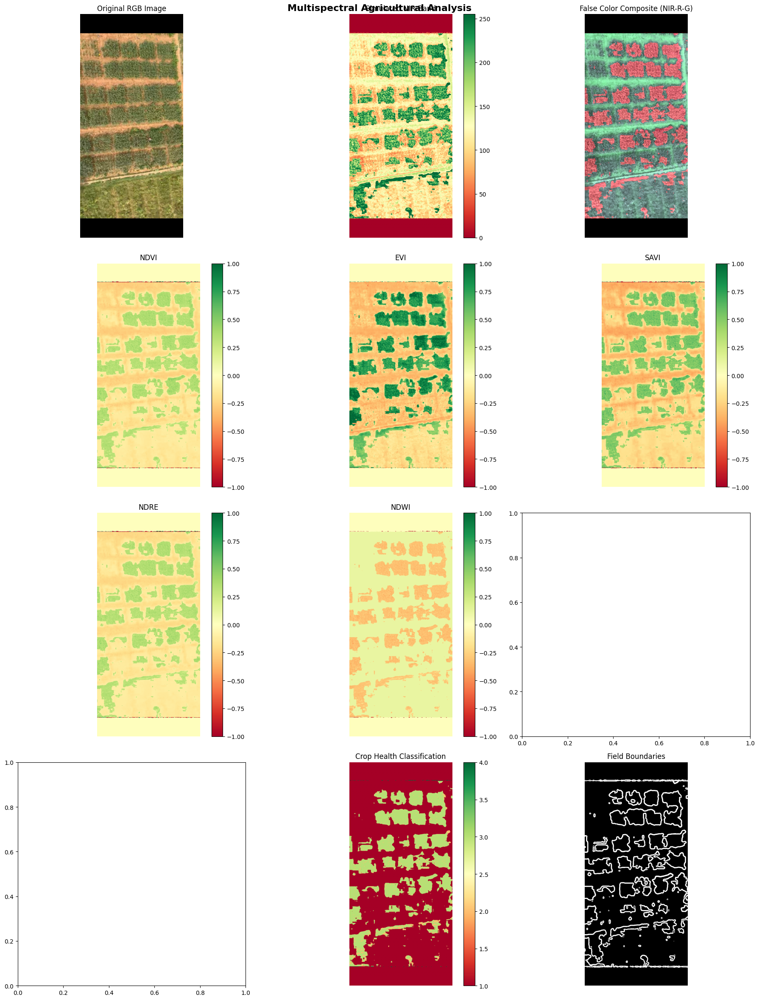

Creating interactive visualization...



        MULTISPECTRAL CROP HEALTH ANALYSIS REPORT

        VEGETATION INDEX SUMMARY:
        NDVI: Mean=-0.023, Std=0.226
        EVI:  Mean=0.023, Std=0.455

        CROP HEALTH DISTRIBUTION:
        Healthy: 0.1%
        Moderate: 21.8%
        Stressed: 2.1%
        Bare Soil/Water: 75.9%
        
Analyzing field zones...


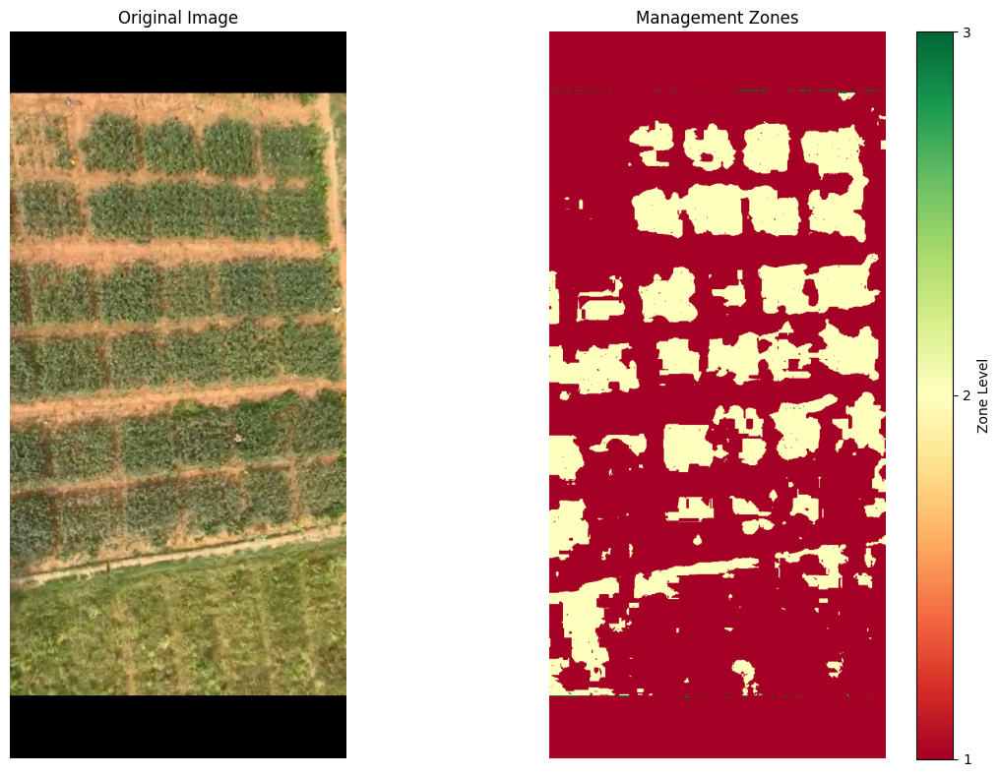

Analysis complete!


In [8]:
# ============================================================
# IMAGE UPLOAD & RUN PIPELINE
# ============================================================
print("Please upload an aerial image for analysis:")
uploaded = files.upload()

if not uploaded:
    raise ValueError("No files uploaded.")

image_path = list(uploaded.keys())[0]
print(f"Using uploaded file: {image_path}")

analyzer, bands, indices, health_map, stats = run_multispectral_analysis(image_path)

print("Analyzing field zones...")
zones = analyze_field_zones(analyzer, indices)

print("Analysis complete!")